In [48]:
import pandas as pd
import datetime as dt
import cufflinks as cf
from plotly.offline import init_notebook_mode, plot, iplot
from plotly.subplots import make_subplots
import plotly.graph_objects as go
init_notebook_mode(connected=True)
cf.go_offline()

In [49]:
data = pd.read_csv("../data/clean_data/univariate_Q_Kalltveit/univariate_Q_Kalltveit.csv", index_col="Datetime")
target = "Q_Kalltveit"
data.index = pd.to_datetime(data.index)
data.describe()

,Q_Kalltveit
count,63288.000000
mean,6.509245
std,7.565526
min,0.000000
25%,2.683190
50%,4.097010
75%,7.141195
max,110.256270


In [50]:
data.rolling(24).mean().rolling(365).mean().iplot()

In [51]:
import plotly.express as px

fig = px.line(data, y='Q_Kalltveit', title='Time Series with Range Slider and Selectors')

fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig.show()

In [52]:

fig = px.histogram(data, x=f"{target}", title=f"Histogram of the {target} data")
fig.show()

In [53]:
groups = data.groupby(pd.Grouper(freq='A'))

years = pd.DataFrame()
i = 0
for name, group in groups:
    df = pd.DataFrame()
    df[name.year] = group.values.flatten()
    years = pd.concat([years, df], axis=1)
years

,2015,2016,2017,2018,2019,2020,2021,2022
0,3.37060,4.32772,43.15430,5.11766,44.09501,10.82828,2.26723,10.04821
1,3.45242,4.31299,40.37590,5.20757,40.86654,10.65999,2.27336,9.80186
2,3.56260,4.29093,37.66038,5.24685,38.18334,10.48755,2.27336,9.60989
3,3.74423,4.29842,35.06653,5.25079,36.21171,10.31602,2.27030,9.36218
4,4.02901,4.49868,32.78852,5.23506,34.51144,10.12102,2.25499,9.09763
...,...,...,...,...,...,...,...,...
8779,NaN,59.89135,NaN,NaN,NaN,2.32568,NaN,NaN
8780,NaN,55.51160,NaN,NaN,NaN,2.30101,NaN,NaN
8781,NaN,51.69854,NaN,NaN,NaN,2.28871,NaN,NaN
8782,NaN,48.63593,NaN,NaN,NaN,2.27336,NaN,NaN


In [54]:
years.rolling(24).mean().rolling(365).mean().iplot()

In [55]:
fig = make_subplots(rows=8, cols=1)

i = 1
for year in years.columns:
    fig.append_trace(go.Scatter(
        x= data.index[:len(years.iloc[:, 0])],
        y= years[year]
    ), row=i, col=1)
    i += 1
fig.update_layout(height=600, width=600, title_text=f"Yearly {target}")
fig.show()

In [56]:
fig = px.box(years, title=f"Yearly Box and Whisker Plots of the {target} data")
fig.show()

In [57]:
one_year = data["2020"]
groups = one_year.groupby(pd.Grouper(freq='M'))
months = pd.concat([pd.DataFrame(x[1].values) for x in groups], axis=1)
months = pd.DataFrame(months)
months.columns = range(1,13)
fig = px.box(months, title=f"Monthly Box and Whisker Plots of the {target} data")
fig.show()

C:\Users\magnu\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:1: FutureWarning:

Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.



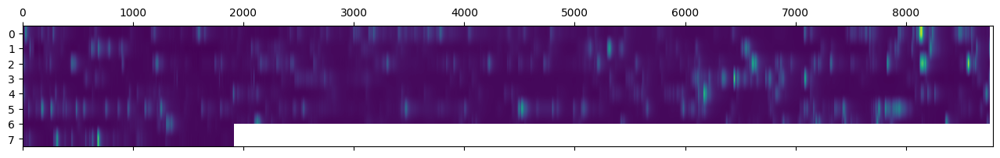

In [58]:
from matplotlib import pyplot

groups = data.groupby(pd.Grouper(freq='A'))
years = pd.DataFrame()
for name, group in groups:
    df = pd.DataFrame()
    df[name.year] = group.values.flatten()
    years = pd.concat([years, df], axis=1)
years = years.T
pyplot.matshow(years, interpolation=None, aspect='auto')
pyplot.show()

C:\Users\magnu\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:1: FutureWarning:

Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.



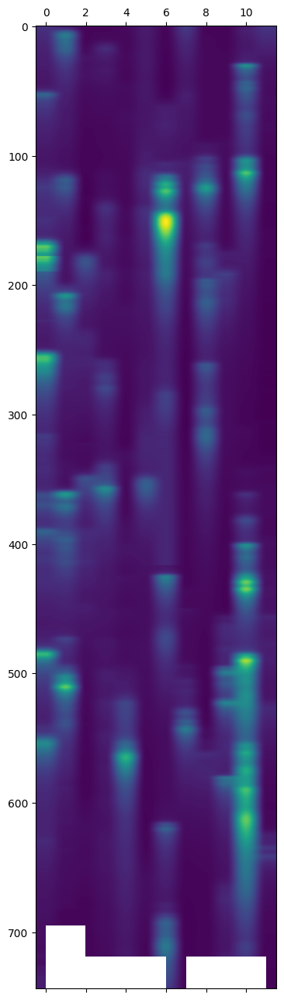

In [59]:

one_year = data['2020']
groups = one_year.groupby(pd.Grouper(freq='M'))
months = pd.concat([pd.DataFrame(x[1].values) for x in groups], axis=1)
months = pd.DataFrame(months)
months.columns = range(1,13)
pyplot.matshow(months, interpolation=None, aspect='auto')
pyplot.show()

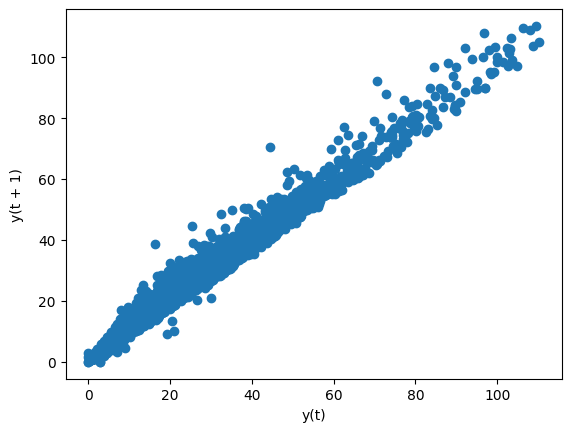

In [60]:
from pandas.plotting import lag_plot
lag_plot(data)
pyplot.show()

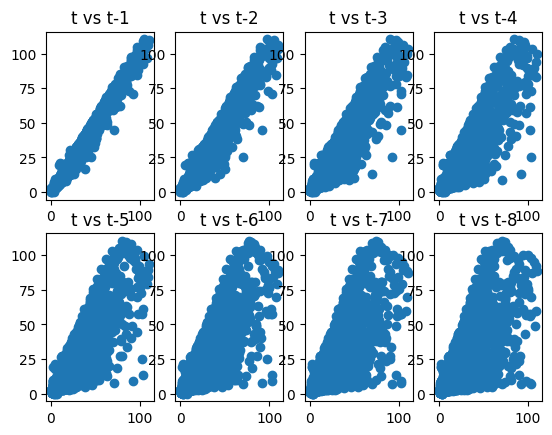

In [61]:
values = pd.DataFrame(data.values)
lags = 8
columns = [values]
for i in range(1,(lags + 1)):
    columns.append(values.shift(i))
dataframe = pd.concat(columns, axis=1)
columns = ['t']
for i in range(1,(lags + 1)):
    columns.append('t-' + str(i))
dataframe.columns = columns
pyplot.figure(1)
for i in range(1,(lags + 1)):
    ax = pyplot.subplot(240 + i)
    ax.set_title('t vs t-' + str(i))
    pyplot.scatter(x=dataframe['t'].values, y=dataframe['t-'+str(i)].values)
pyplot.show()

In [62]:
from statsmodels.tsa.stattools import pacf, acf
import numpy as np
import plotly.graph_objects as go

df_pacf = pacf(data.values, nlags=72)
fig = go.Figure()
fig.add_trace(go.Scatter(
    x= np.arange(len(df_pacf)),
    y= df_pacf,
    name= 'PACF',
    ))
fig.update_xaxes(rangeslider_visible=True)
fig.update_layout(
    title="Partial Autocorrelation",
    xaxis_title="Lag",
    yaxis_title="Partial Autocorrelation",
    #     autosize=False,
    #     width=500,
         height=500,
    )
fig.show()

In [63]:

def create_corr_plot(series, plot_pacf=False):
    corr_array = pacf(series.dropna(), alpha=0.05) if plot_pacf else acf(series.dropna(), alpha=0.05)
    lower_y = corr_array[1][:,0] - corr_array[0]
    upper_y = corr_array[1][:,1] - corr_array[0]

    fig = go.Figure()
    [fig.add_scatter(x=(x,x), y=(0,corr_array[0][x]), mode='lines',line_color='#3f3f3f') 
     for x in range(len(corr_array[0]))]
    fig.add_scatter(x=np.arange(len(corr_array[0])), y=corr_array[0], mode='markers', marker_color='#1f77b4',
                   marker_size=12)
    fig.add_scatter(x=np.arange(len(corr_array[0])), y=upper_y, mode='lines', line_color='rgba(255,255,255,0)')
    fig.add_scatter(x=np.arange(len(corr_array[0])), y=lower_y, mode='lines',fillcolor='rgba(32, 146, 230,0.3)',
            fill='tonexty', line_color='rgba(255,255,255,0)')
    fig.update_traces(showlegend=False)
    fig.update_xaxes(range=[-1,42])
    fig.update_yaxes(zerolinecolor='#000000')
    
    title='Partial Autocorrelation (PACF)' if plot_pacf else 'Autocorrelation (ACF)'
    fig.update_layout(title=title)
    fig.show()
create_corr_plot(data)

In [64]:
create_corr_plot(data, True)

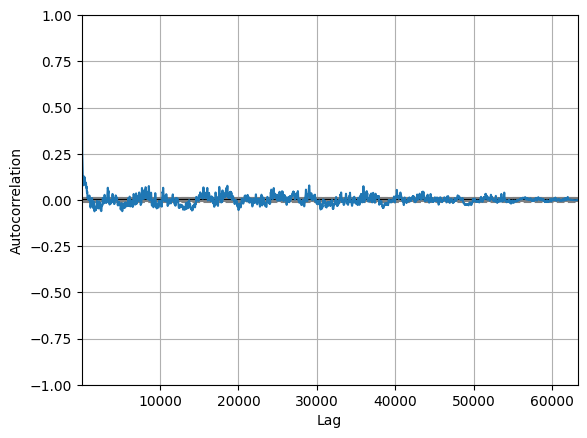

In [65]:
from pandas.plotting import autocorrelation_plot

autocorrelation_plot(data)
pyplot.show()

C:\Users\magnu\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:5: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



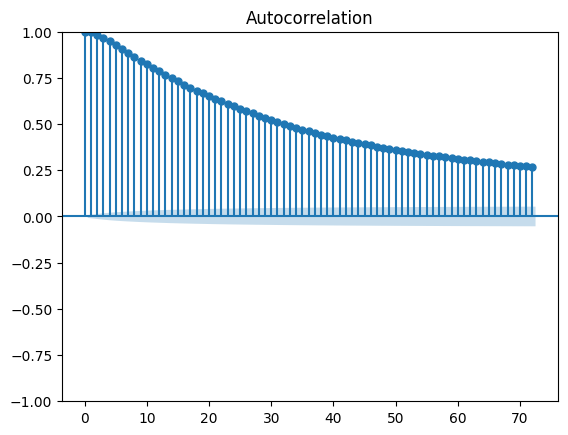

In [66]:
from statsmodels.graphics import tsaplots

# Display the autocorrelation plot of your time series
fig = tsaplots.plot_acf(data[target], lags=72)
fig.show()

c:\Users\magnu\AppData\Local\Programs\Python\Python37\lib\site-packages\statsmodels\graphics\tsaplots.py:353: FutureWarning:

The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.



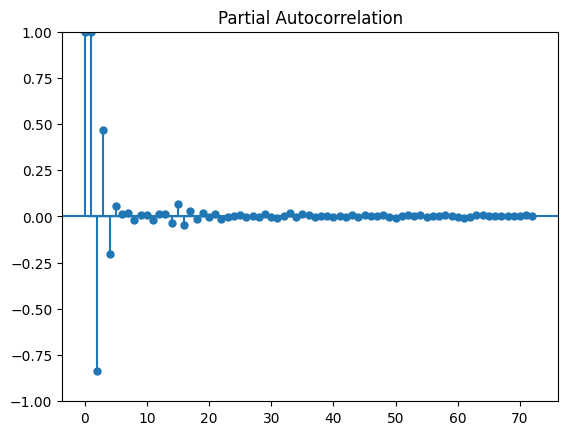

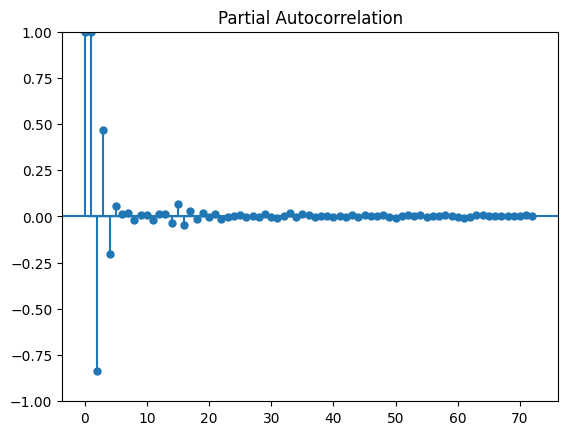

In [67]:
from statsmodels.graphics.tsaplots import plot_pacf
plot_pacf(data, lags=72)

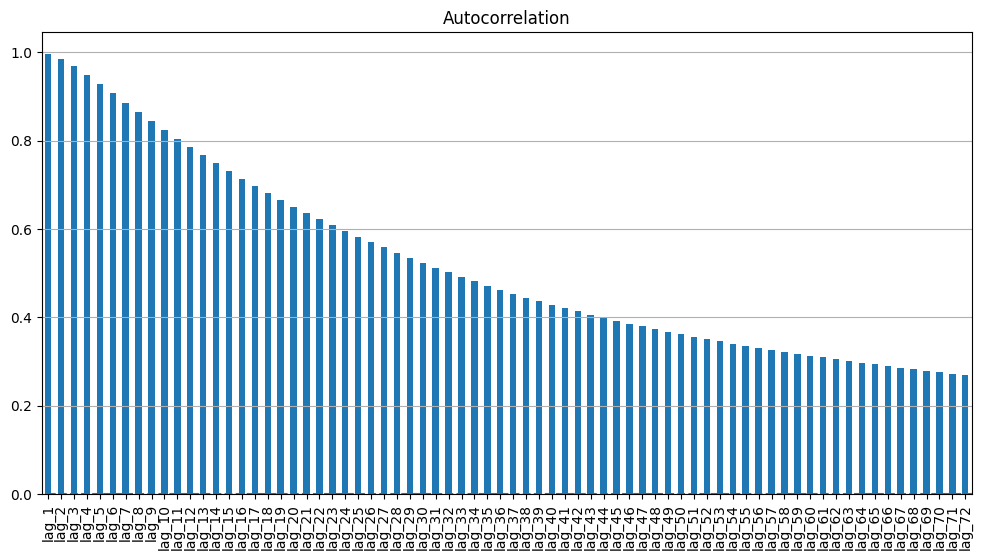

In [68]:
auto_cor = data.groupby("Datetime")[target].sum()
auto_cor = pd.DataFrame(auto_cor)
auto_cor.columns = ["y"]

# Adding the lag of the target variable from 1 steps back up to 72 (due to a seasonality at the end of the year)
for i in range(1, 73):
    auto_cor["lag_{}".format(i)] = auto_cor.y.shift(i)

# Compute autocorrelation of the series and its lags
lag_corr = auto_cor.corr()
lag_corr = lag_corr.iloc[1:,0]
lag_corr.columns = ["corr"]
order = lag_corr.abs().sort_values(ascending = False)
lag_corr = lag_corr[order.index]

# Plot the Autocorrelation
plt.figure(figsize=(12, 6))
lag_corr.plot(kind='bar')
plt.grid(True, axis='y')
plt.title("Autocorrelation")
plt.hlines(y=0, xmin=0, xmax=len(lag_corr), linestyles='dashed')